In [ ]:
from nfstream import NFStreamer, NFPlugin
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
import joblib
import pickle
import ipaddress

In [1]:
# Function that do the following operation on all application : DNS.Facebook & HTTP.Facebook & N.Facebook ==> Facebook)
def clean_app(app):
    global new_L, indicator, YN, L
    app = str(app)
    indicator = '.'
    YN = app.find(indicator)
    if YN != -1:
        return ''.join(list(app)[YN+1:])
    else: return app

# Live Capture from interface with statistical analysis
interface = 'pcap.pcap'
my_streamer = NFStreamer(source=interface,
                   decode_tunnels=True,
                   bpf_filter=None,
                   promiscuous_mode=True,
                   snapshot_length=1536,
                   idle_timeout=120,
                   active_timeout=1800,
                   accounting_mode=0,
                   udps=None,
                   n_dissections=20,
                   statistical_analysis=True,
                   splt_analysis=0,
                   n_meters=0,
                   performance_report=0)
print('Capturing and converting to dataframe')

# Creating the dataframe
df = pd.DataFrame(columns=['IP src', 'IP dst', 'Port src', 'Port dst', 'IPv', 'Bytes', 'Packets', 
                           'Duration(ms)', 'Max PS', 'PS Deviation', 'Mean PIAT(ms)', 'Server Name',
                           'Application', 'Category'])

print('Empty dataframe created')
print('Filling the dataframe')
for flow in my_streamer:
    all_rows = [flow.src_ip, flow.dst_ip, flow.src_port, flow.dst_port, flow.ip_version, flow.bidirectional_bytes, 
                flow.bidirectional_packets, flow.bidirectional_duration_ms, flow.bidirectional_max_ps, 
                flow.bidirectional_stddev_ps, flow.bidirectional_mean_piat_ms, flow.requested_server_name, 
                flow.application_name, flow.application_category_name]  
    df.loc[flow.id] = all_rows
#    df.loc[flow.id, 'Application'] = clean_app(df.loc[flow.id, 'Application'])
    if flow.id == 30000:
        break
print('Dataframe filled')
print(df["Category"].value_counts())
print('Cleaning ...')
# Cleaning the dataframe
df.drop(df[df['IPv'] == 6].index, inplace = True) #Deleting ipv6
df.drop(df[df['Category'] == 'Unspecified'].index, inplace = True) #Deleting ipv6
df.loc[(abs(df['Mean PIAT(ms)']) <= 80) & (abs(df['Mean PIAT(ms)']) > 10) & ((df['Category'] == 'Web') | (df['Category'] == 'Network')) & (df['Server Name'] != '') & (df['Application'] != 'Google') & (df['Application'] != 'DNS') , 'Category'] = 'Streaming'
df.loc[(df['Category'] == 'Media') | (df['Category'] == 'Video'), 'Category'] = 'Streaming'
df.loc[(df['Server Name'] == 'w.bs-share.com'), 'Category'] = 'Streaming'
df.loc[(df['Category'] == 'Music'), 'Category'] = 'Streaming'
df.loc[(df['Server Name'] == 'pushmail.eodatacenter.com'), 'Category'] = 'Email'
df.loc[(df['Category'] == 'RemoteAccess'), 'Category'] = 'Network'
df.loc[(df['Category'] == 'RemoteAccess'), 'Category'] = 'Network'
df.loc[(df['Category'] == 'SoftwareUpdate'), 'Category'] = 'Download'

# Defning upstream or downstream and the server application ip address
print('Adding up and down and the application server ip to the dataframe')

# List client's network ip addresses on the server
list_ip_clients = ['197.26.19.0/24','196.224.64.0/21','196.224.128.0/20','197.27.0.0/19','196.224.144.0/20','197.27.64.0/20',
'197.25.0.0/19','197.27.80.0/21','197.27.192.0/19','197.27.88.0/22','197.29.0.0/19','197.27.94.0/23','197.31.192.0/19',
'197.30.128.0/19','41.224.64.0/20','197.31.128.0/19','165.51.220.0/22','41.224.192.0/20','197.27.92.0/23'] 

def verif_ip_in_net(ip_clients, ip_add): # Function to verify if an ip address is on a network
    for i in range(len(ip_clients)):
        TF = ipaddress.ip_address(ip_add) in ipaddress.ip_network(ip_clients[i])
        if TF == True:
            return True
        else: continue
    return False

list_index = df.index
for i in list_index: # Applying the previous function and adding the up/down and the ip app columns to the dataframe
    TFsrc = verif_ip_in_net(list_ip_clients, df.loc[i,'IP src'])
    TFdst = verif_ip_in_net(list_ip_clients, df.loc[i,'IP dst'])
    df.loc[i, 'up down'] = np.where(TFsrc == True, 'up', 'down')
    df.loc[i, 'IP app'] = np.where(df.loc[i, 'up down'] == 'up', df.loc[i, 'IP dst'], df.loc[i, 'IP src'])

print('up and down and application server ip added to the dataframe')
pd.set_option("display.max_rows", None, "display.max_columns", None)
print('\nDataframe resulted:\n')
df
# Verifying the categories 
print(df["Category"].value_counts())
#sns.countplot(y = df['Category'])

Capturing and converting to dataframe
Empty dataframe created
Filling the dataframe
Dataframe filled
Web               11313
Unspecified        7627
SocialNetwork      4896
Cloud              1673
Network            1672
VoIP               1291
Chat                321
Media               229
Video               211
VPN                 204
Download            175
Email                97
Advertisement        66
System               57
SoftwareUpdate       56
ConnCheck            23
RemoteAccess         19
Game                 19
IoT-Scada            15
Collaborative        11
RPC                   8
Streaming             6
DataTransfer          4
VirtAssistant         2
Music                 2
Cybersecurity         2
Mining                1
Database              1
Name: Category, dtype: int64
Cleaning ...
Adding up and down and the application server ip to the dataframe
up and down and application server ip added to the dataframe

Dataframe resulted:

Web              11169
SocialNetwork

<AxesSubplot:xlabel='count', ylabel='Category'>

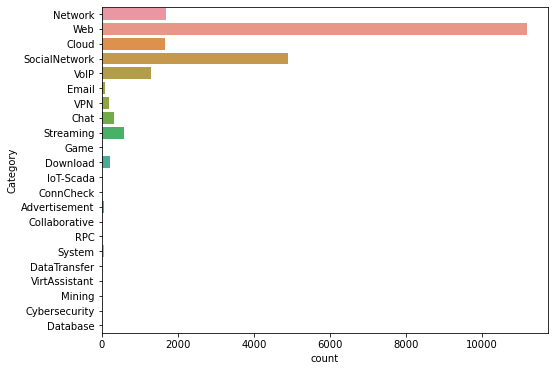

In [2]:
plt.figure(figsize=(8,6))
sns.countplot(y = df['Category'])

Web              11169
SocialNetwork     4896
Network           1691
Cloud             1673
VoIP              1291
Others             625
Streaming          589
Chat               321
Email               97
Game                19
Name: Category, dtype: int64


<AxesSubplot:xlabel='count', ylabel='Category'>

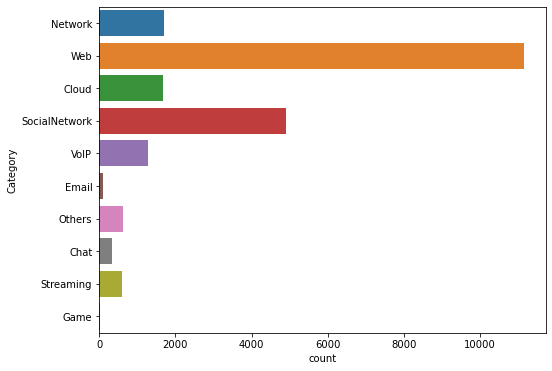

In [4]:
# Categories Selection
dict_cat = ['Web', 'SocialNetwork', 'Streaming', 'Email', 'Chat', 'Game', 'Cloud', 'Network', 'VoIP']

def select_cat(dict_cat, category):
    for j in range(len(dict_cat)):
        if category == dict_cat[j]:
            tf = True
            return True
        else : tf = False
    return False

list_index = df.index
for i in list_index: # Applying the previous function and adding the up/down and the ip app columns to the dataframe
    TF = select_cat(dict_cat, df.loc[i,'Category'])
    df.loc[i, 'selected_cat'] = np.where(TF == True, 'yes', 'no')

for i in list_index:
        if df.loc[i,'selected_cat'] == 'no':
            df.loc[i,'Category'] = 'Others'
    
#df.drop(df[df['selected_cat'] == 'no'].index, inplace = True)

print(df["Category"].value_counts())
plt.figure(figsize=(8,6))
sns.countplot(y = df['Category'])

In [5]:
# Function that converts ip into binary
def list_binary_ips(df):
    ip = []
    for i in df.index:
        k = df.loc[i, 'IP app']
        ki = np.array2string(k, separator=',', formatter={'str_kind': lambda x: x})
        ip.append(ki)
    for i in range(len(ip)):
        x = ip[i]
        z = 0
        parts = x.split('.')
        z = (int(parts[0]) << 24) + (int(parts[1]) << 16) + (int(parts[2]) << 8) + int(parts[3])
        ip[i]= z
    return ip
ip_app = list_binary_ips(df)
df.loc[:,'IP_app_converted'] = ip_app

In [6]:
le = LabelEncoder()
data = df['Application']
values = np.array(data)
df['Application'] = le.fit_transform(values)
data = df['Category']
values = np.array(data)
df['Category'] = le.fit_transform(values)

In [7]:
X = df.drop(columns=['up down','Category', 'Server Name', 'IP src', 'IP dst', 'IPv', 'IP app', 'selected_cat', 'Application'])
y = df['Category']
X.head()

,Port src,Port dst,Bytes,Packets,Duration(ms),Max PS,PS Deviation,Mean PIAT(ms),IP_app_converted
0,38735,41292,817,8,1312,146,28.412460,187.428571,3303860334
1,46198,443,1505,20,96,80,1.118034,5.052632,2398795850
2,10505,443,1314,19,1261,78,5.428967,70.055556,3303353100
3,49385,1813,2449,6,1292,409,2.041241,258.400000,168564441
5,34851,443,105792,76,1321,1392,0.000000,17.613333,1682156403


In [8]:
# Features selection
from sklearn.feature_selection import chi2
chi2_features = SelectKBest(chi2, k = 6)
X_kbest_features = chi2_features.fit_transform(X, y)
cols = chi2_features.get_support(indices=True)
print("All features =", X.shape[1])
print("Most important features =", X_kbest_features.shape[1])
X_kbest_features = features_df_new = X.iloc[:,cols]
X_kbest_features.head(7)

All features = 9
Most important features = 6


,Port src,Port dst,Bytes,Duration(ms),Max PS,IP_app_converted
0,38735,41292,817,1312,146,3303860334
1,46198,443,1505,96,80,2398795850
2,10505,443,1314,1261,78,3303353100
3,49385,1813,2449,1292,409,168564441
5,34851,443,105792,1321,1392,1682156403
6,35164,40008,77567,1317,1228,1682222362
7,44425,443,1084,794,227,2398795822


(111690, 6)
(111690,)
VoIP             11169
Streaming        11169
Email            11169
Others           11169
Network          11169
Cloud            11169
SocialNetwork    11169
Game             11169
Chat             11169
Web              11169
Name: Category, dtype: int64


<AxesSubplot:xlabel='count', ylabel='Category'>

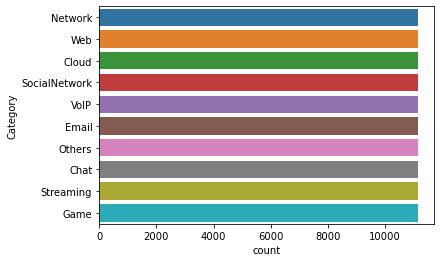

In [9]:
# Balencing the data with over sampling
from imblearn.over_sampling import SMOTE
st=SMOTE(k_neighbors = 1)
x_res,y_res=st.fit_sample(X_kbest_features,y)
print(x_res.shape)
print(y_res.shape)
df_over=pd.DataFrame(x_res)
df_over["Category"]=y_res
data = df_over['Category']
values = np.array(data)
df_over['Category'] = le.inverse_transform(values)
print(df_over["Category"].value_counts())
sns.countplot(y= df_over["Category"])

In [10]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
df_over.to_pickle('Network Flow DataFrame')

,IP src,IP dst,Port src,Port dst,IPv,Bytes,Packets,Duration(ms),Max PS,PS Deviation,Mean PIAT(ms),Server Name,Application,Category,up down,IP app,selected_cat,IP_app_converted
0,196.236.232.110,197.25.156.132,38735,41292,4,817,8,1312,146,28.412460,187.428571,,126,4,down,196.236.232.110,yes,3303860334
1,196.224.155.227,142.250.184.74,46198,443,4,1505,20,96,80,1.118034,5.052632,,48,9,up,142.250.184.74,yes,2398795850
2,196.229.43.12,138.199.14.24,10505,443,4,1314,19,1261,78,5.428967,70.055556,,139,9,down,196.229.43.12,yes,3303353100
3,10.12.22.217,10.45.6.25,49385,1813,4,2449,6,1292,409,2.041241,258.400000,,114,4,down,10.12.22.217,yes,168564441
5,100.67.171.115,52.59.97.192,34851,443,4,105792,76,1321,1392,0.000000,17.613333,,1,1,down,100.67.171.115,yes,1682156403
6,100.68.173.26,157.240.203.48,35164,40008,4,77567,90,1317,1228,432.184354,14.797753,,46,6,down,100.68.173.26,yes,1682222362
7,197.29.22.107,142.250.184.46,44425,443,4,1084,11,794,227,51.991083,79.400000,,48,9,up,142.250.184.46,yes,2398795822
8,197.25.3.235,52.18.51.21,53734,443,4,1139,3,96,969,510.731175,48.000000,,142,1,up,52.18.51.21,yes,873607957
9,100.76.97.106,157.240.196.49,34512,57889,4,29739,48,1324,1011,416.326177,28.170213,,46,6,down,100.76.97.106,yes,1682727274
10,100.70.12.240,197.29.120.99,43415,3478,4,1846,9,1160,263,78.600961,145.000000,,126,4,down,100.70.12.240,yes,1682312432
